# %config InlineBackend.figure_format='retina'

import pylab as plt
import glob
import numpy as np
import pandas as pd
from PIL import Image

f_ab = pd.read_csv("gz_decals_volunteers_ab.csv")
f_c = pd.read_csv("gz_decals_volunteers_c.csv")
f_sdss = pd.read_csv("gz2_hart16_modded.csv")# Compiling Galaxy10 DES

In [1]:
# %config InlineBackend.figure_format='retina'

import pylab as plt
import glob
import numpy as np
import pandas as pd
from PIL import Image

f_ab = pd.read_csv("gz_decals_volunteers_ab.csv")
f_c = pd.read_csv("gz_decals_volunteers_c.csv")
f_sdss = pd.read_csv("gz2_hart16_modded_z.csv")

print(len(f_ab), len(f_c), len(f_sdss))

f_ab = f_ab[~f_ab["in_gzd_c"]]
f_sdss = f_sdss[~f_sdss["in_gz_des_abc"]]

print(len(f_ab), len(f_c), len(f_sdss))

92960 253286 238947
60503 253286 127983


In [2]:
# %config InlineBackend.figure_format='retina'

import pylab as plt
import glob
import numpy as np
import pandas as pd
from PIL import Image

f_ab = pd.read_csv("gz_decals_volunteers_ab.csv")
f_c = pd.read_csv("gz_decals_volunteers_c.csv")
f_sdss = pd.read_csv("gz2_hart16_modded_z.csv")

# images with bad edges
bad_pix_ab = np.genfromtxt("edges_result_ab_cropped.csv")
bad_pix_c = np.genfromtxt("edges_result_c_cropped.csv")
bad_pix_sdss = np.genfromtxt("edges_result_gz2_cropped.csv")

# galaxy size estimation
gsize_ab = np.genfromtxt("gsize_result_ab.csv")
gsize_c = np.genfromtxt("gsize_result_c.csv")
gsize_sdss = np.genfromtxt("gsize_result_gz2.csv")

cropping_threshold = 17500
cropping_x = 128
cropping_y = 384
new_h = 256
new_w = 256
native_pixel_resolution = 0.262

# images folder
jpg_ab_ls = glob.glob("jpeg_ab/*.jpg")
jpg_c_ls = glob.glob("jpeg_c/*.jpg")
jpg_sdss_ls = glob.glob("gz2_des/*.jpg")
f_ab["jpg_filename"] = jpg_ab_ls
f_c["jpg_filename"] = jpg_c_ls
f_sdss["jpg_filename"] = jpg_sdss_ls
f_ab["gsize"] = gsize_ab
f_c["gsize"] = gsize_c
f_sdss["gsize"] = gsize_sdss
f_ab["bad_pix"] = bad_pix_ab
f_c["bad_pix"] = bad_pix_c
f_sdss["bad_pix"] = bad_pix_sdss
f_ab["pxscale"] = np.ones_like(gsize_ab) * native_pixel_resolution
f_c["pxscale"] = np.ones_like(gsize_c) * native_pixel_resolution
f_sdss["pxscale"] = np.ones_like(gsize_sdss) * native_pixel_resolution
f_ab.loc[f_ab["gsize"]>cropping_threshold, "pxscale"] = native_pixel_resolution * 2
f_c.loc[f_c["gsize"]>cropping_threshold, "pxscale"] = native_pixel_resolution * 2
f_sdss.loc[f_sdss["gsize"]>cropping_threshold, "pxscale"] = native_pixel_resolution * 2

# remove overlaps (define gz_decals_volunteers_c.csv as the reference)
f_ab = f_ab[~f_ab["in_gzd_c"]]
f_sdss = f_sdss[~f_sdss["in_gz_des_abc"]]

# good images indices
f_ab_good = f_ab[(f_ab["smooth-or-featured_total-votes"]>10) & (f_ab["bad_pix"]<3) & (f_ab["gsize"]>3000)]
f_ab_good_no_distrib = f_ab_good[(f_ab_good["merging_neither_fraction"]>0.6) & (f_ab_good["merging_total-votes"]>10)]

# good images indices
f_c_good = f_c[(f_c["smooth-or-featured_total-votes"]>10) & (f_c["bad_pix"]<3) & (f_c["gsize"]>3000)]
f_c_good_no_distrib = f_c_good[(f_c_good["merging_none_fraction"]>0.6) & (f_c_good["merging_total-votes"]>10)]

# good images indices
# use total number of counts in first question as a proxy of total votes
f_sdss_good = f_sdss[(f_sdss["t01_smooth_or_features_a01_smooth_count"]+
                      f_sdss["t01_smooth_or_features_a02_features_or_disk_count"]+
                      f_sdss["t01_smooth_or_features_a03_star_or_artifact_count"]>10) & (f_sdss["bad_pix"]<3) & (f_sdss["gsize"]>3000)]
f_sdss_good_no_distrib = f_sdss_good[(f_sdss_good["t06_odd_a15_no_count"]>0.9) & (f_sdss_good["t06_odd_a15_no_count"]>9)]

print(f"Length of good galaxies in ab: {len(f_ab_good)}")
print(f"Length of good galaxies in c: {len(f_c_good)}")
print(f"Length of good galaxies in gz2/sdss: {len(f_sdss_good)}")

print(f"Length of not disturbed good galaxies in ab: {len(f_ab_good_no_distrib)}")
print(f"Length of not disturbed good galaxies in c: {len(f_c_good_no_distrib)}")
print(f"Length of not disturbed good galaxies in gz2/sdss: {len(f_sdss_good_no_distrib)}")

Length of good galaxies in ab: 48283
Length of good galaxies in c: 56849
Length of good galaxies in gz2/sdss: 102819
Length of not disturbed good galaxies in ab: 40992
Length of not disturbed good galaxies in c: 30308
Length of not disturbed good galaxies in gz2/sdss: 99060


In [3]:
def read_all_img(ab_filepaths, c_filepaths, gz2_filepaths, gsize_ab, gsize_c, gsize_gz2):
    all_img = []
    for filepaths, gsize in zip([ab_filepaths, c_filepaths, gz2_filepaths], [gsize_ab, gsize_c, gsize_gz2]):
        for f, g in zip(filepaths, gsize):
            if g>cropping_threshold:
                img = Image.fromarray(plt.imread(f)).resize(size=(new_h, new_w))
            else:
                img = plt.imread(f)[cropping_x:cropping_y, cropping_x:cropping_y, :]
            all_img.append(img)
    return np.stack(all_img)

Number from ab: 172, Number from c: 328, Number from sdss: 581
Total: 1081


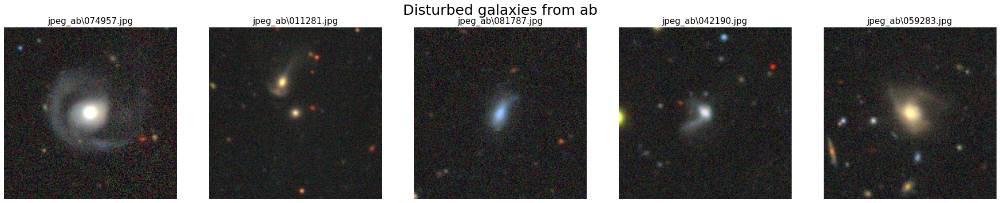

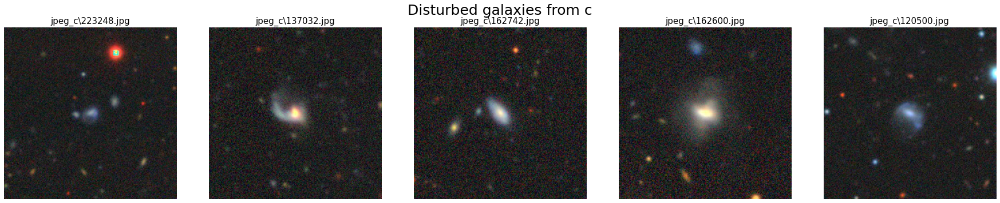

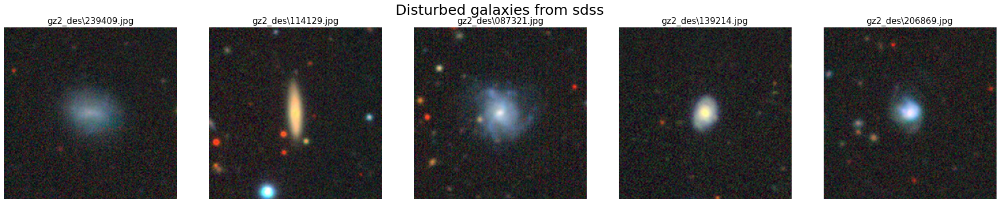

In [4]:
# Disturbed galaxy but not merging

disturbed_ab = ((f_ab_good["merging_tidal-debris_fraction"]>0.5) & 
                (f_ab_good["merging_total-votes"]>10) & 
                (f_ab_good["merging_merger_fraction"]<0.2))

disturbed_c = (((f_c_good["merging_major-disturbance_fraction"]>0.5) | (f_c_good["merging_minor-disturbance_fraction"]>0.7)) & 
               (f_c_good["merging_total-votes"]>10) & 
               (f_c_good["merging_merger_fraction"]<0.2))

disturbed_sdss = ((((f_sdss_good["t08_odd_feature_a21_disturbed_fraction"]>0.8) & (f_sdss_good["t08_odd_feature_a21_disturbed_count"]>8)) | 
                   ((f_sdss_good["t08_odd_feature_a22_irregular_fraction"]>0.8) & (f_sdss_good["t08_odd_feature_a22_irregular_count"]>8)) ) & 
                  (f_sdss_good["t08_odd_feature_a24_merger_fraction"]<0.2))

print(f"Number from ab: {np.sum(disturbed_ab)}, Number from c: {np.sum(disturbed_c)}, Number from sdss: {np.sum(disturbed_sdss)}")
print(f"Total: {np.sum(disturbed_ab) + np.sum(disturbed_c) + np.sum(disturbed_sdss)}")

random_idx = np.random.randint(0, np.sum(disturbed_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good[disturbed_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good[disturbed_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Disturbed galaxies from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(disturbed_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good[disturbed_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good[disturbed_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])    
    ax[i].axis("off")
fig.suptitle("Disturbed galaxies from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(disturbed_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good[disturbed_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good[disturbed_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])    
    ax[i].axis("off")
fig.suptitle("Disturbed galaxies from sdss", fontsize=25)
fig.tight_layout()

disturbed_imgs = read_all_img(f_ab_good[disturbed_ab]["jpg_filename"], 
                              f_c_good[disturbed_c]["jpg_filename"], 
                              f_sdss_good[disturbed_sdss]["jpg_filename"],
                              f_ab_good[disturbed_ab]["gsize"], 
                              f_c_good[disturbed_c]["gsize"], 
                              f_sdss_good[disturbed_sdss]["gsize"])

Number from ab: 425, Number from c: 513, Number from sdss: 915
Total: 1853


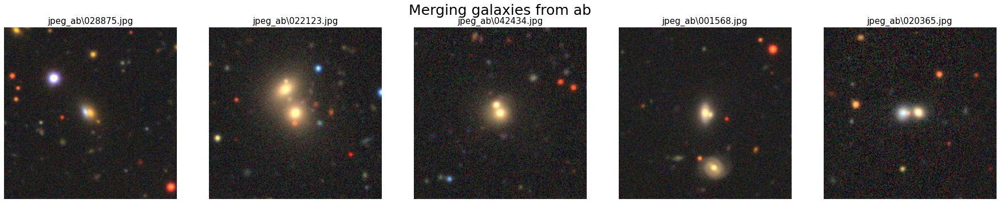

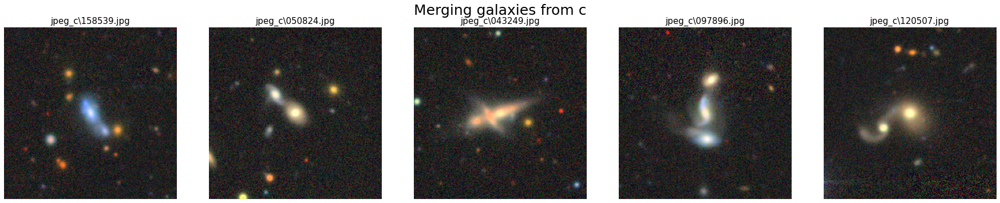

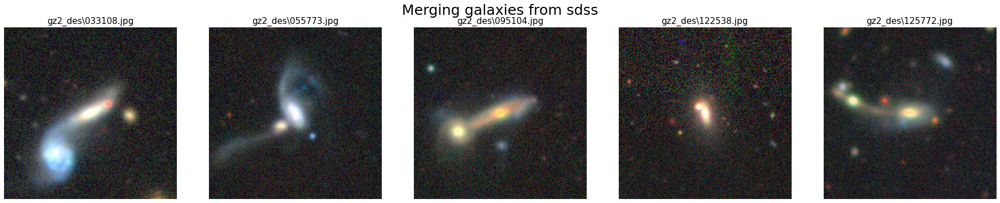

In [5]:
# Merging galaxies

merging_ab = ((f_ab_good["merging_merger_fraction"]>0.7) & 
              (f_ab_good["merging_total-votes"]>10))

merging_c = ((f_c_good["merging_merger_fraction"]>0.7) & 
             (f_c_good["merging_total-votes"]>10))

merging_sdss = ((f_sdss_good["t08_odd_feature_a24_merger_fraction"]>0.7) & 
                (f_sdss_good["t08_odd_feature_a24_merger_count"]>7))

print(f"Number from ab: {np.sum(merging_ab)}, Number from c: {np.sum(merging_c)}, Number from sdss: {np.sum(merging_sdss)}")
print(f"Total: {np.sum(merging_ab) + np.sum(merging_c) + np.sum(merging_sdss)}")

random_idx = np.random.randint(0, np.sum(disturbed_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good[merging_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good[merging_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Merging galaxies from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(disturbed_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good[merging_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good[merging_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Merging galaxies from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(disturbed_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good[merging_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good[merging_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Merging galaxies from sdss", fontsize=25)
fig.tight_layout()

merging_imgs = read_all_img(f_ab_good[merging_ab]["jpg_filename"], 
                            f_c_good[merging_c]["jpg_filename"], 
                            f_sdss_good[merging_sdss]["jpg_filename"],
                            f_ab_good[merging_ab]["gsize"], 
                            f_c_good[merging_c]["gsize"], 
                            f_sdss_good[merging_sdss]["gsize"])

Number from ab: 1214, Number from c: 508, Number from sdss: 923
Total: 2645


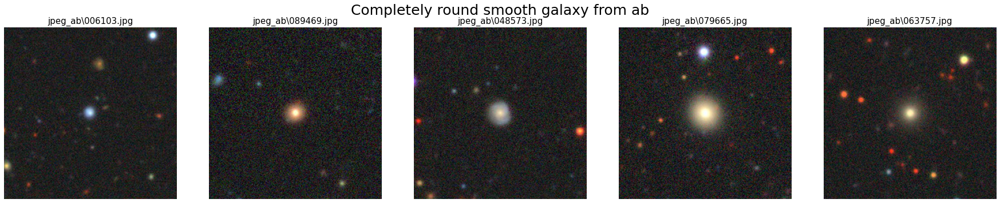

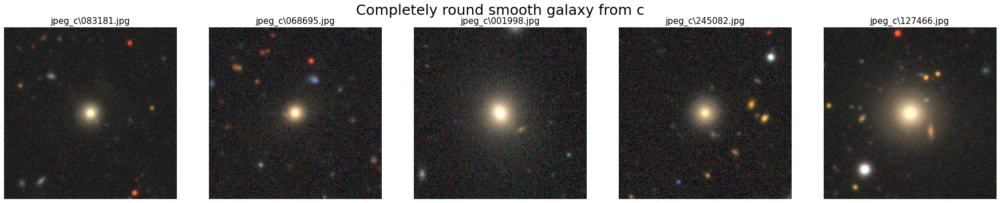

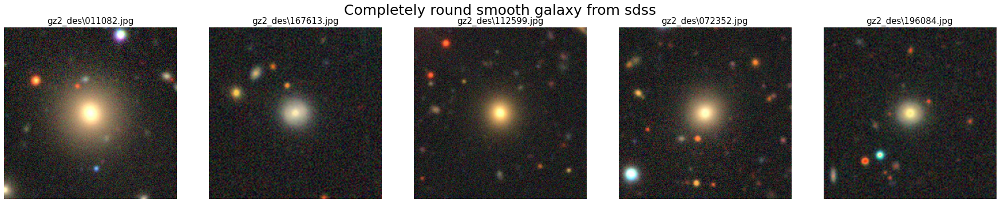

In [6]:
# Completely round smooth galaxy

round_smooth_ab = ((f_ab_good_no_distrib["how-rounded_completely_fraction"]==1.) & 
                   (f_ab_good_no_distrib["how-rounded_total-votes"]>20))

round_smooth_c = ((f_c_good_no_distrib["how-rounded_round_fraction"]==1.) & 
                  (f_c_good_no_distrib["how-rounded_total-votes"]>20))

round_smooth_sdss = ((f_sdss_good_no_distrib["t07_rounded_a16_completely_round_count"]>20) & 
                     (f_sdss_good_no_distrib["t07_rounded_a16_completely_round_fraction"]==1.))

print(f"Number from ab: {np.sum(round_smooth_ab)}, Number from c: {np.sum(round_smooth_c)}, Number from sdss: {np.sum(round_smooth_sdss)}")
print(f"Total: {np.sum(round_smooth_ab) + np.sum(round_smooth_c) + np.sum(round_smooth_sdss)}")

random_idx = np.random.randint(0, np.sum(round_smooth_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[round_smooth_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[round_smooth_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Completely round smooth galaxy from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(round_smooth_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[round_smooth_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[round_smooth_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Completely round smooth galaxy from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(round_smooth_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[round_smooth_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[round_smooth_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Completely round smooth galaxy from sdss", fontsize=25)
fig.tight_layout()

round_smooth_imgs = read_all_img(f_ab_good_no_distrib[round_smooth_ab]["jpg_filename"], 
                            f_c_good_no_distrib[round_smooth_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[round_smooth_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[round_smooth_ab]["gsize"], 
                            f_c_good_no_distrib[round_smooth_c]["gsize"], 
                            f_sdss_good_no_distrib[round_smooth_sdss]["gsize"])

Number from ab: 198, Number from c: 206, Number from sdss: 1623
Total: 2027


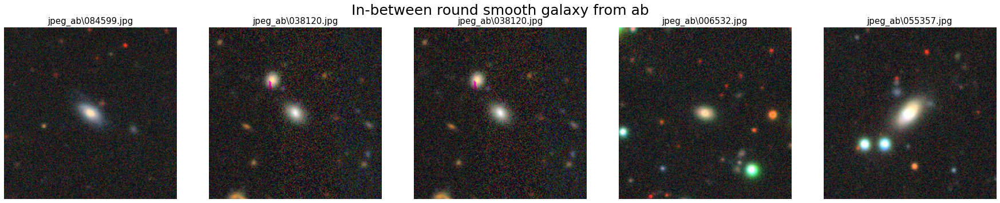

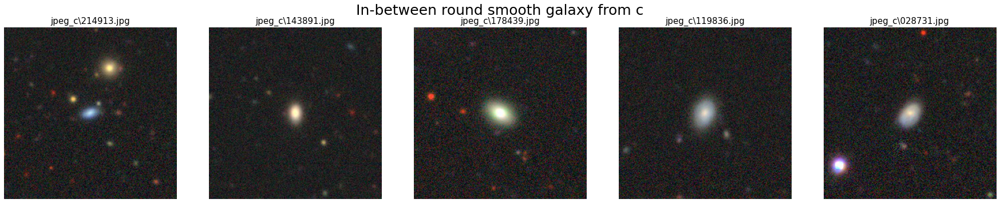

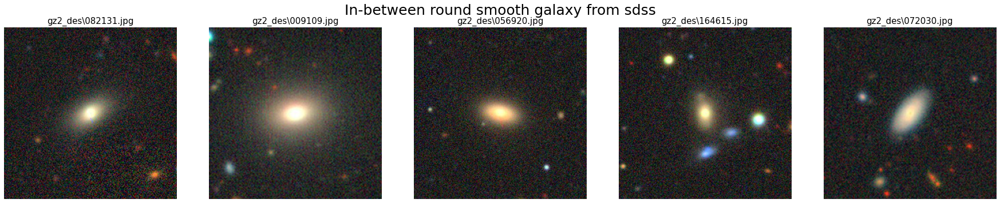

In [7]:
# In-between round smooth galaxy

inbetween_round_smooth_ab = ((f_ab_good_no_distrib["smooth-or-featured_smooth_fraction"]>0.9) & 
                             (f_ab_good_no_distrib["how-rounded_in-between_fraction"]>0.8) & 
                             (f_ab_good_no_distrib["how-rounded_total-votes"]>20))

inbetween_round_smooth_c = ((f_c_good_no_distrib["smooth-or-featured_smooth_fraction"]>0.9) & 
                            (f_c_good_no_distrib["how-rounded_in-between_fraction"]>0.8) & 
                            (f_c_good_no_distrib["how-rounded_total-votes"]>20))

inbetween_round_smooth_sdss = ((f_sdss_good_no_distrib["t01_smooth_or_features_a01_smooth_fraction"]>0.9) & 
                               (f_sdss_good_no_distrib["t07_rounded_a17_in_between_count"]>9) & 
                               (f_sdss_good_no_distrib["t07_rounded_a17_in_between_fraction"]>0.9))

print(f"Number from ab: {np.sum(inbetween_round_smooth_ab)}, Number from c: {np.sum(inbetween_round_smooth_c)}, Number from sdss: {np.sum(inbetween_round_smooth_sdss)}")
print(f"Total: {np.sum(inbetween_round_smooth_ab) + np.sum(inbetween_round_smooth_c) + np.sum(inbetween_round_smooth_sdss)}")

random_idx = np.random.randint(0, np.sum(inbetween_round_smooth_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[inbetween_round_smooth_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[inbetween_round_smooth_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("In-between round smooth galaxy from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(inbetween_round_smooth_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[inbetween_round_smooth_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[inbetween_round_smooth_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("In-between round smooth galaxy from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(inbetween_round_smooth_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[inbetween_round_smooth_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[inbetween_round_smooth_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("In-between round smooth galaxy from sdss", fontsize=25)
fig.tight_layout()

inbetween_round_smooth_imgs = read_all_img(f_ab_good_no_distrib[inbetween_round_smooth_ab]["jpg_filename"], 
                            f_c_good_no_distrib[inbetween_round_smooth_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[inbetween_round_smooth_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[inbetween_round_smooth_ab]["gsize"], 
                            f_c_good_no_distrib[inbetween_round_smooth_c]["gsize"], 
                            f_sdss_good_no_distrib[inbetween_round_smooth_sdss]["gsize"])

Number from ab: 3, Number from c: 90, Number from sdss: 241
Total: 334


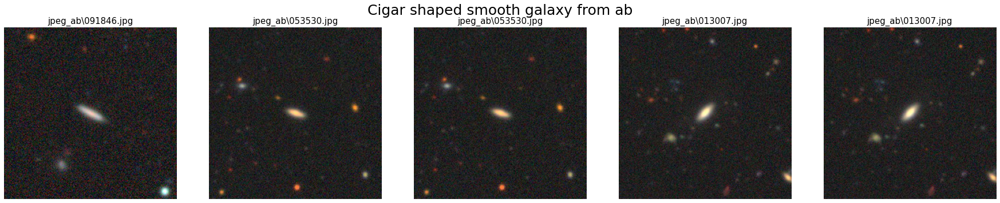

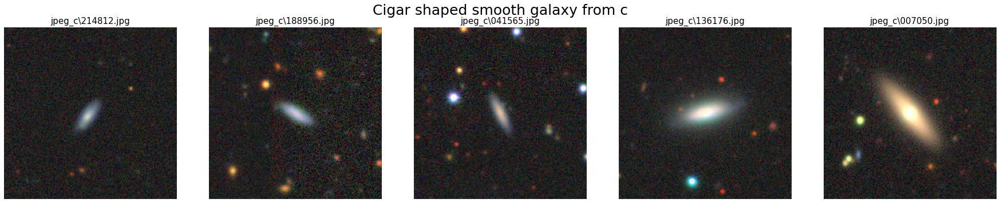

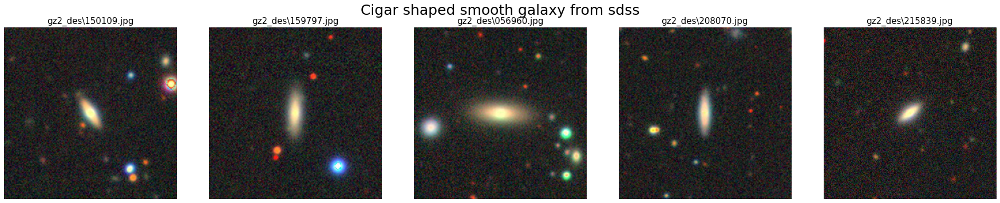

In [8]:
# Cigar shaped smooth galaxy

cigar_round_smooth_ab = ((f_ab_good_no_distrib["smooth-or-featured_smooth_fraction"]>0.9) & 
                         (f_ab_good_no_distrib["how-rounded_cigar-shaped_fraction"]>0.5) & 
                         (f_ab_good_no_distrib["how-rounded_total-votes"]>10))

cigar_round_smooth_c = ((f_c_good_no_distrib["smooth-or-featured_smooth_fraction"]>0.9) & 
                        (f_c_good_no_distrib["how-rounded_cigar-shaped_fraction"]>0.5) & 
                        (f_c_good_no_distrib["how-rounded_total-votes"]>10))

cigar_round_smooth_sdss = ((f_sdss_good_no_distrib["t01_smooth_or_features_a01_smooth_fraction"]>0.9) & 
                           (f_sdss_good_no_distrib["t07_rounded_a18_cigar_shaped_count"]>5) & 
                           (f_sdss_good_no_distrib["t07_rounded_a18_cigar_shaped_fraction"]>0.5))

print(f"Number from ab: {np.sum(cigar_round_smooth_ab)}, Number from c: {np.sum(cigar_round_smooth_c)}, Number from sdss: {np.sum(cigar_round_smooth_sdss)}")
print(f"Total: {np.sum(cigar_round_smooth_ab) + np.sum(cigar_round_smooth_c) + np.sum(cigar_round_smooth_sdss)}")

random_idx = np.random.randint(0, np.sum(cigar_round_smooth_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[cigar_round_smooth_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[cigar_round_smooth_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Cigar shaped smooth galaxy from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(cigar_round_smooth_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[cigar_round_smooth_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[cigar_round_smooth_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Cigar shaped smooth galaxy from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(cigar_round_smooth_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[cigar_round_smooth_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[cigar_round_smooth_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Cigar shaped smooth galaxy from sdss", fontsize=25)
fig.tight_layout()

cigar_round_smooth_imgs = read_all_img(f_ab_good_no_distrib[cigar_round_smooth_ab]["jpg_filename"], 
                            f_c_good_no_distrib[cigar_round_smooth_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[cigar_round_smooth_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[cigar_round_smooth_ab]["gsize"], 
                            f_c_good_no_distrib[cigar_round_smooth_c]["gsize"], 
                            f_sdss_good_no_distrib[cigar_round_smooth_sdss]["gsize"])

Number from ab: 61, Number from c: 741, Number from sdss: 1241
Total: 2043


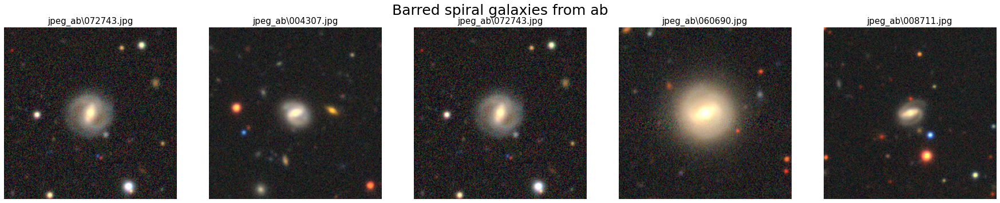

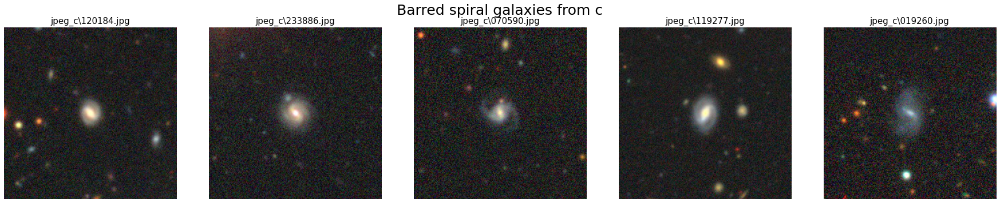

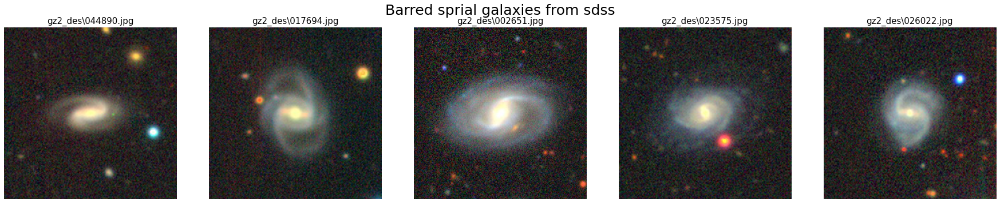

In [9]:
# Barred spiral face-on galaxy

barred_ab = ((f_ab_good_no_distrib["has-spiral-arms_yes_fraction"]>0.8) & 
             (f_ab_good_no_distrib["spiral-winding_total-votes"]>5) & 
             (f_ab_good_no_distrib["bar_total-votes"]>5) & 
             (f_ab_good_no_distrib["bar_no_fraction"]<0.2))

barred_c = ((f_c_good_no_distrib["has-spiral-arms_yes_fraction"]>0.8) & 
            (f_c_good_no_distrib["spiral-winding_total-votes"]>5) & 
            (f_c_good_no_distrib["bar_total-votes"]>5) & 
            (f_c_good_no_distrib["bar_no_fraction"]<0.2))

barred_sdss = ((f_sdss_good_no_distrib["t04_spiral_a08_spiral_count"]>8) & 
               (f_sdss_good_no_distrib["t04_spiral_a08_spiral_fraction"]>0.8) & 
               (f_sdss_good_no_distrib["t03_bar_a06_bar_count"]>8) & 
               (f_sdss_good_no_distrib["t03_bar_a06_bar_fraction"]>0.8))

print(f"Number from ab: {np.sum(barred_ab)}, Number from c: {np.sum(barred_c)}, Number from sdss: {np.sum(barred_sdss)}")
print(f"Total: {np.sum(barred_ab) + np.sum(barred_c) + np.sum(barred_sdss)}")

random_idx = np.random.randint(0, np.sum(barred_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[barred_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[barred_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Barred spiral galaxies from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(barred_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[barred_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[barred_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Barred spiral galaxies from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(barred_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[barred_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[barred_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Barred sprial galaxies from sdss", fontsize=25)
fig.tight_layout()

barred_imgs = read_all_img(f_ab_good_no_distrib[barred_ab]["jpg_filename"], 
                            f_c_good_no_distrib[barred_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[barred_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[barred_ab]["gsize"], 
                            f_c_good_no_distrib[barred_c]["gsize"], 
                            f_sdss_good_no_distrib[barred_sdss]["gsize"])

Number from ab: 644, Number from c: 459, Number from sdss: 726
Total: 1829


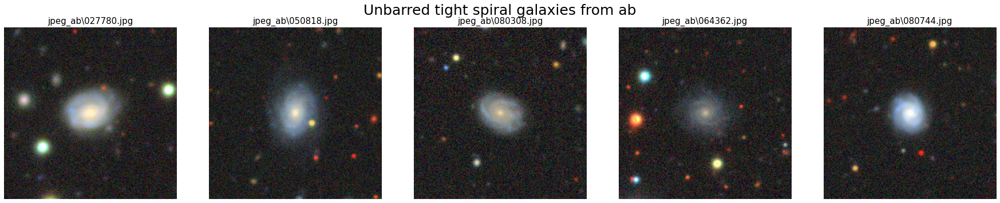

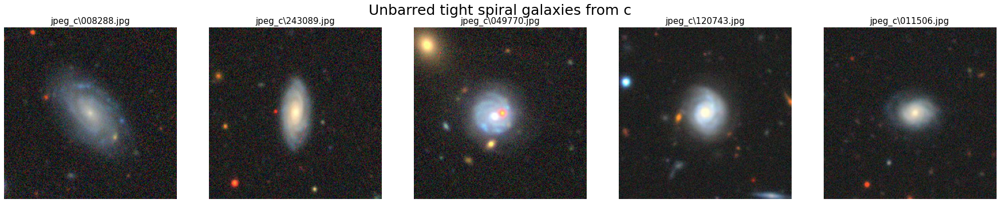

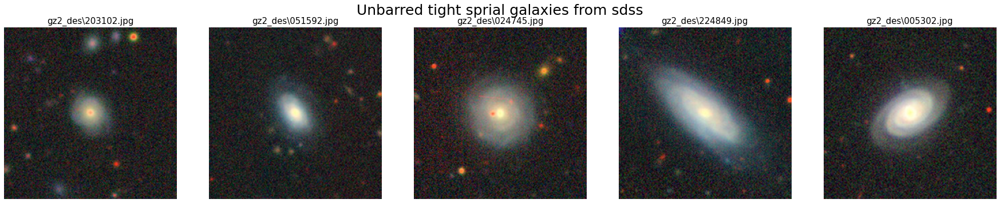

In [10]:
# Unbarred tight spiral face-on galaxy

unbarred_tight_ab = ((f_ab_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.5) & 
                     (f_ab_good_no_distrib["spiral-winding_tight_fraction"]>0.65) & 
                     (f_ab_good_no_distrib["spiral-winding_total-votes"]>10) & 
                     (f_ab_good_no_distrib["bar_total-votes"]>10) & 
                     (f_ab_good_no_distrib["bar_no_fraction"]>0.8))

unbarred_tight_c = ((f_c_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.5) & 
                    (f_c_good_no_distrib["spiral-winding_tight_fraction"]>0.65) & 
                    (f_c_good_no_distrib["spiral-winding_total-votes"]>10) & 
                    (f_c_good_no_distrib["bar_total-votes"]>10) & 
                    (f_c_good_no_distrib["bar_no_fraction"]>0.8))

unbarred_tight_sdss = ((f_sdss_good_no_distrib["t10_arms_winding_a28_tight_fraction"]>0.8) & 
                       (f_sdss_good_no_distrib["t10_arms_winding_a28_tight_count"]>8) & 
                       (f_sdss_good_no_distrib["t03_bar_a07_no_bar_count"]>8) & 
                       (f_sdss_good_no_distrib["t03_bar_a07_no_bar_fraction"]>0.8))

print(f"Number from ab: {np.sum(unbarred_tight_ab)}, Number from c: {np.sum(unbarred_tight_c)}, Number from sdss: {np.sum(unbarred_tight_sdss)}")
print(f"Total: {np.sum(unbarred_tight_ab) + np.sum(unbarred_tight_c) + np.sum(unbarred_tight_sdss)}")

random_idx = np.random.randint(0, np.sum(unbarred_tight_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[unbarred_tight_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[unbarred_tight_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Unbarred tight spiral galaxies from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(unbarred_tight_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[unbarred_tight_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[unbarred_tight_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Unbarred tight spiral galaxies from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(unbarred_tight_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[unbarred_tight_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[unbarred_tight_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Unbarred tight sprial galaxies from sdss", fontsize=25)
fig.tight_layout()

unbarred_tight_imgs = read_all_img(f_ab_good_no_distrib[unbarred_tight_ab]["jpg_filename"], 
                            f_c_good_no_distrib[unbarred_tight_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[unbarred_tight_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[unbarred_tight_ab]["gsize"], 
                            f_c_good_no_distrib[unbarred_tight_c]["gsize"], 
                            f_sdss_good_no_distrib[unbarred_tight_sdss]["gsize"])

Number from ab: 551, Number from c: 120, Number from sdss: 1957
Total: 2628


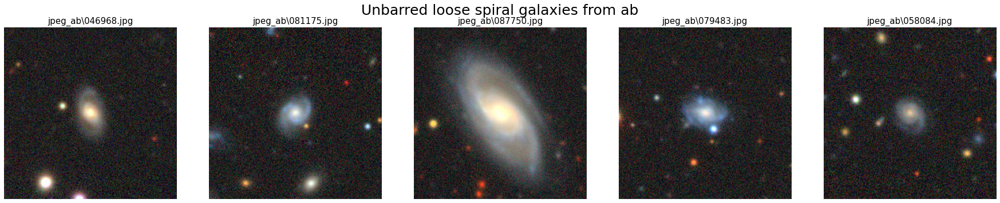

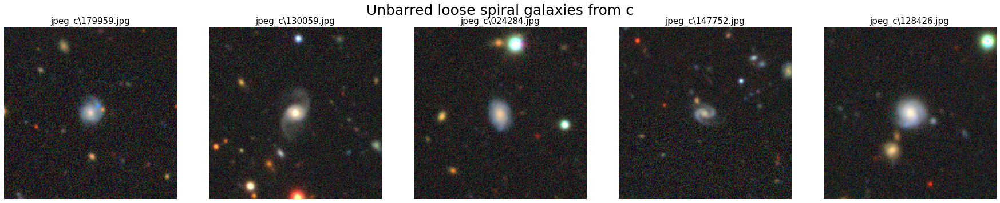

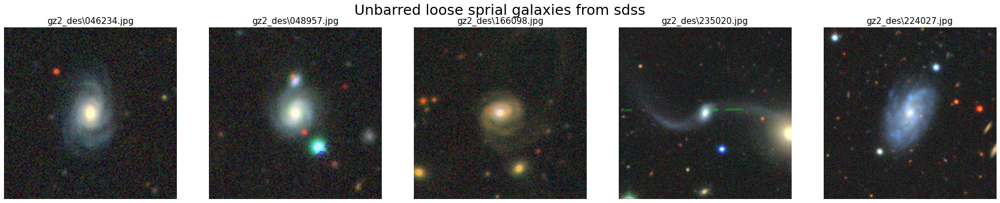

In [11]:
# Unbarred loose spiral face-on galaxy

unbarred_loose_ab = ((f_ab_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.6) & 
                     (f_ab_good_no_distrib["spiral-winding_tight_fraction"]<0.5) & 
                     (f_ab_good_no_distrib["has-spiral-arms_yes_fraction"]>0.8) & 
                     (f_ab_good_no_distrib["bar_total-votes"]>5) & 
                     (f_ab_good_no_distrib["bar_no_fraction"]>0.8))

unbarred_loose_c = ((f_c_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.6) & 
                    (f_c_good_no_distrib["spiral-winding_tight_fraction"]<0.5) & 
                    (f_c_good_no_distrib["has-spiral-arms_yes_fraction"]>0.8) & 
                    (f_c_good_no_distrib["bar_total-votes"]>5) & 
                    (f_c_good_no_distrib["bar_no_fraction"]>0.8))

unbarred_loose_sdss = ((f_sdss_good_no_distrib["t10_arms_winding_a28_tight_fraction"]<0.5) & 
                       (f_sdss_good_no_distrib["t10_arms_winding_a30_loose_count"]>5) & 
                       (f_sdss_good_no_distrib["t03_bar_a07_no_bar_count"]>8) & 
                       (f_sdss_good_no_distrib["t03_bar_a07_no_bar_fraction"]>0.8))

print(f"Number from ab: {np.sum(unbarred_loose_ab)}, Number from c: {np.sum(unbarred_loose_c)}, Number from sdss: {np.sum(unbarred_loose_sdss)}")
print(f"Total: {np.sum(unbarred_loose_ab) + np.sum(unbarred_loose_c) + np.sum(unbarred_loose_sdss)}")

random_idx = np.random.randint(0, np.sum(unbarred_loose_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[unbarred_loose_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[unbarred_loose_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Unbarred loose spiral galaxies from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(unbarred_loose_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[unbarred_loose_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[unbarred_loose_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Unbarred loose spiral galaxies from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(unbarred_loose_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[unbarred_loose_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[unbarred_loose_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Unbarred loose sprial galaxies from sdss", fontsize=25)
fig.tight_layout()

unbarred_loose_imgs = read_all_img(f_ab_good_no_distrib[unbarred_loose_ab]["jpg_filename"], 
                            f_c_good_no_distrib[unbarred_loose_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[unbarred_loose_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[unbarred_loose_ab]["gsize"], 
                            f_c_good_no_distrib[unbarred_loose_c]["gsize"], 
                            f_sdss_good_no_distrib[unbarred_loose_sdss]["gsize"])

Number from ab: 218, Number from c: 271, Number from sdss: 934
Total: 1423


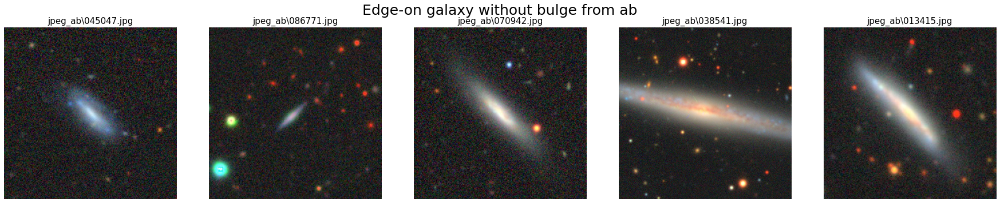

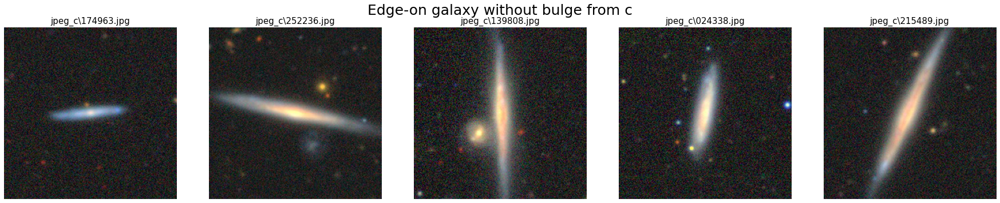

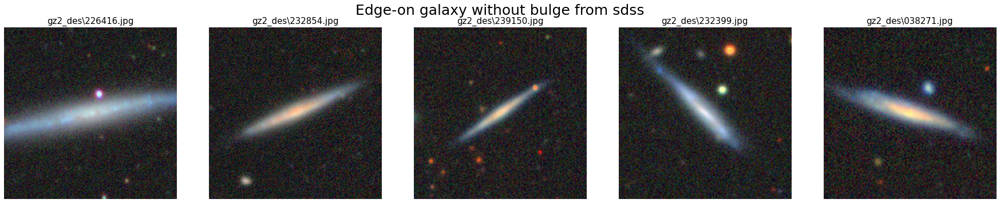

In [12]:
# Edge-on galaxy without bulge

edgeon_nobulge_ab = ((f_ab_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.5) & 
                     (f_ab_good_no_distrib["edge-on-bulge_none_fraction"]>0.6) & 
                     (f_ab_good_no_distrib["edge-on-bulge_total-votes"]>10))

edgeon_nobulge_c = ((f_c_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.5) & 
                    (f_c_good_no_distrib["edge-on-bulge_none_fraction"]>0.6) & 
                    (f_c_good_no_distrib["edge-on-bulge_total-votes"]>10))



edgeon_nobulge_sdss = ((f_sdss_good_no_distrib["t01_smooth_or_features_a02_features_or_disk_fraction"]>0.5) & 
                       (f_sdss_good_no_distrib["t02_edgeon_a04_yes_fraction"]>0.5) & 
                       (f_sdss_good_no_distrib["t09_bulge_shape_a27_no_bulge_fraction"]>0.6))

print(f"Number from ab: {np.sum(edgeon_nobulge_ab)}, Number from c: {np.sum(edgeon_nobulge_c)}, Number from sdss: {np.sum(edgeon_nobulge_sdss)}")
print(f"Total: {np.sum(edgeon_nobulge_ab) + np.sum(edgeon_nobulge_c) + np.sum(edgeon_nobulge_sdss)}")

random_idx = np.random.randint(0, np.sum(edgeon_nobulge_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[edgeon_nobulge_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[edgeon_nobulge_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Edge-on galaxy without bulge from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(edgeon_nobulge_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[edgeon_nobulge_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[edgeon_nobulge_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Edge-on galaxy without bulge from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(edgeon_nobulge_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[edgeon_nobulge_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[edgeon_nobulge_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Edge-on galaxy without bulge from sdss", fontsize=25)
fig.tight_layout()

edgeon_nobulge_imgs = read_all_img(f_ab_good_no_distrib[edgeon_nobulge_ab]["jpg_filename"], 
                            f_c_good_no_distrib[edgeon_nobulge_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[edgeon_nobulge_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[edgeon_nobulge_ab]["gsize"], 
                            f_c_good_no_distrib[edgeon_nobulge_c]["gsize"], 
                            f_sdss_good_no_distrib[edgeon_nobulge_sdss]["gsize"])

Number from ab: 468, Number from c: 875, Number from sdss: 530
Total: 1873


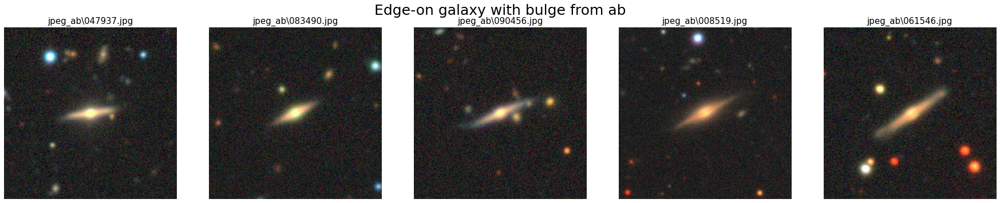

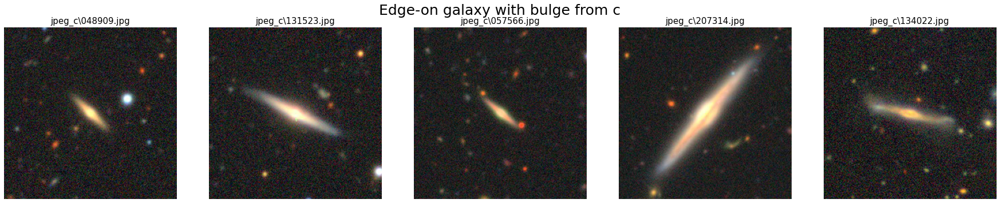

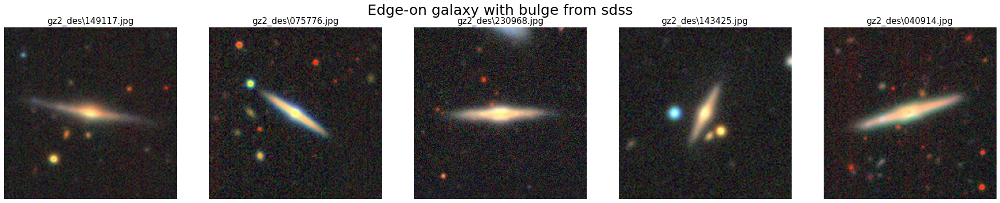

In [13]:
# Edge-on galaxy with bulge

edgeon_bulge_ab = ((f_ab_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.6) & 
                   (f_ab_good_no_distrib["edge-on-bulge_none_fraction"]<0.1) & 
                   (f_ab_good_no_distrib["edge-on-bulge_total-votes"]>10))

edgeon_bulge_c = ((f_c_good_no_distrib["smooth-or-featured_featured-or-disk_fraction"]>0.6) & 
                  (f_c_good_no_distrib["edge-on-bulge_none_fraction"]<0.1) & 
                  (f_c_good_no_distrib["edge-on-bulge_total-votes"]>10))

edgeon_bulge_sdss = ((f_sdss_good_no_distrib["t01_smooth_or_features_a02_features_or_disk_fraction"]>0.6) & 
                     (f_sdss_good_no_distrib["t02_edgeon_a04_yes_fraction"]==1.) & 
                     (f_sdss_good_no_distrib["t09_bulge_shape_a27_no_bulge_fraction"]<0.1))

print(f"Number from ab: {np.sum(edgeon_bulge_ab)}, Number from c: {np.sum(edgeon_bulge_c)}, Number from sdss: {np.sum(edgeon_bulge_sdss)}")
print(f"Total: {np.sum(edgeon_bulge_ab) + np.sum(edgeon_bulge_c) + np.sum(edgeon_bulge_sdss)}")

random_idx = np.random.randint(0, np.sum(edgeon_bulge_ab), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_ab_good_no_distrib[edgeon_bulge_ab].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_ab_good_no_distrib[edgeon_bulge_ab].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Edge-on galaxy with bulge from ab", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(edgeon_bulge_c), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_c_good_no_distrib[edgeon_bulge_c].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_c_good_no_distrib[edgeon_bulge_c].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Edge-on galaxy with bulge from c", fontsize=25)
fig.tight_layout()


random_idx = np.random.randint(0, np.sum(edgeon_bulge_sdss), 5)
fig, ax = plt.subplots(1, 5, figsize=(25, 5), dpi=72)
for i in range(5):
    filepath = f_sdss_good_no_distrib[edgeon_bulge_sdss].reset_index()["jpg_filename"][random_idx[i]]
    ax[i].set_title(f"{filepath}", fontsize=15)
    if f_sdss_good_no_distrib[edgeon_bulge_sdss].reset_index()["gsize"][random_idx[i]]>cropping_threshold:
        ax[i].imshow(plt.imread(filepath))
    else:
        ax[i].imshow(plt.imread(filepath)[cropping_x:cropping_y, cropping_x:cropping_y, :])
    ax[i].axis("off")
fig.suptitle("Edge-on galaxy with bulge from sdss", fontsize=25)
fig.tight_layout()

edgeon_bulge_imgs = read_all_img(f_ab_good_no_distrib[edgeon_bulge_ab]["jpg_filename"], 
                            f_c_good_no_distrib[edgeon_bulge_c]["jpg_filename"], 
                            f_sdss_good_no_distrib[edgeon_bulge_sdss]["jpg_filename"],
                            f_ab_good_no_distrib[edgeon_bulge_ab]["gsize"], 
                            f_c_good_no_distrib[edgeon_bulge_c]["gsize"], 
                            f_sdss_good_no_distrib[edgeon_bulge_sdss]["gsize"])

In [14]:
print(len(disturbed_imgs) + len(merging_imgs) + len(round_smooth_imgs) + len(inbetween_round_smooth_imgs) + len(cigar_round_smooth_imgs) + len(barred_imgs) + 
      len(unbarred_tight_imgs) + len(unbarred_loose_imgs) + len(edgeon_nobulge_imgs) + len(edgeon_bulge_imgs))

17736


In [15]:
# Generate an image for README

fig, ax = plt.subplots(10, 5, figsize=(20, 43))

random_idx = np.random.randint(0, len(disturbed_imgs), 5)
for i in range(5):
    ax[0][i].imshow(disturbed_imgs[random_idx[i]])
    ax[0][i].axis("off")
    if i == 2:
        ax[0][i].set_title("Disturbed Galaxies", fontsize=25)
    
random_idx = np.random.randint(0, len(merging_imgs), 5)
for i in range(5):
    ax[1][i].imshow(merging_imgs[random_idx[i]])
    ax[1][i].axis("off")
    if i == 2:
        ax[1][i].set_title("Merging Galaxies", fontsize=25)

random_idx = np.random.randint(0, len(round_smooth_imgs), 5)
for i in range(5):
    ax[2][i].imshow(round_smooth_imgs[random_idx[i]])
    ax[2][i].axis("off")
    if i == 2:
        ax[2][i].set_title("Round Smooth Galaxies", fontsize=25)

random_idx = np.random.randint(0, len(inbetween_round_smooth_imgs), 5)
for i in range(5):
    ax[3][i].imshow(inbetween_round_smooth_imgs[random_idx[i]])
    ax[3][i].axis("off")
    if i == 2:
        ax[3][i].set_title("In-between Round Smooth Galaxies", fontsize=25)
        
random_idx = np.random.randint(0, len(cigar_round_smooth_imgs), 5)
for i in range(5):
    ax[4][i].imshow(cigar_round_smooth_imgs[random_idx[i]])
    ax[4][i].axis("off")
    if i == 2:
        ax[4][i].set_title("Cigar shaped Round Smooth Galaxies", fontsize=25)

random_idx = np.random.randint(0, len(barred_imgs), 5)
for i in range(5):
    ax[5][i].imshow(barred_imgs[random_idx[i]])
    ax[5][i].axis("off")
    if i == 2:
        ax[5][i].set_title("Barred Spiral Galaxies", fontsize=25)
        
random_idx = np.random.randint(0, len(unbarred_tight_imgs), 5)
for i in range(5):
    ax[6][i].imshow(unbarred_tight_imgs[random_idx[i]])
    ax[6][i].axis("off")
    if i == 2:
        ax[6][i].set_title("Unbarred Tight Spiral Galaxies", fontsize=25)

random_idx = np.random.randint(0, len(unbarred_loose_imgs), 5)
for i in range(5):
    ax[7][i].imshow(unbarred_loose_imgs[random_idx[i]])
    ax[7][i].axis("off")
    if i == 2:
        ax[7][i].set_title("Unbarred Loose Spiral Galaxies", fontsize=25)
        
random_idx = np.random.randint(0, len(edgeon_nobulge_imgs), 5)
for i in range(5):
    ax[8][i].imshow(edgeon_nobulge_imgs[random_idx[i]])
    ax[8][i].axis("off")
    if i == 2:
        ax[8][i].set_title("Edge-on Galaxies without Bulge", fontsize=25)

random_idx = np.random.randint(0, len(edgeon_bulge_imgs), 5)
for i in range(5):
    ax[9][i].imshow(edgeon_bulge_imgs[random_idx[i]])
    ax[9][i].axis("off")
    if i == 2:
        ax[9][i].set_title("Edge-on Galaxies with Bulge", fontsize=25)

plt.suptitle("Galaxy10 v2" , fontsize=30)
fig.tight_layout(rect=[0, 0.00, 1, 0.985])
fig.savefig("readme.png")
plt.close(fig)

In [16]:
images = np.concatenate([disturbed_imgs, merging_imgs, round_smooth_imgs, 
                         inbetween_round_smooth_imgs, 
                         cigar_round_smooth_imgs, 
                         barred_imgs, 
                         unbarred_tight_imgs, 
                         unbarred_loose_imgs, 
                         edgeon_nobulge_imgs, 
                         edgeon_bulge_imgs])

classes = np.concatenate([np.ones(len(disturbed_imgs))*0, 
                         np.ones(len(merging_imgs))*1, 
                         np.ones(len(round_smooth_imgs))*2, 
                         np.ones(len(inbetween_round_smooth_imgs))*3, 
                         np.ones(len(cigar_round_smooth_imgs))*4, 
                         np.ones(len(barred_imgs))*5, 
                         np.ones(len(unbarred_tight_imgs))*6, 
                         np.ones(len(unbarred_loose_imgs))*7, 
                         np.ones(len(edgeon_nobulge_imgs))*8, 
                         np.ones(len(edgeon_bulge_imgs))*9])


ra = np.concatenate([f_ab_good[disturbed_ab]['ra'], f_c_good[disturbed_c]['ra'], f_sdss_good[disturbed_sdss]['ra'], 
                     f_ab_good[merging_ab]['ra'], f_c_good[merging_c]['ra'], f_sdss_good[merging_sdss]['ra'],
                     f_ab_good_no_distrib[round_smooth_ab]['ra'], f_c_good_no_distrib[round_smooth_c]['ra'], f_sdss_good_no_distrib[round_smooth_sdss]['ra'],
                     f_ab_good_no_distrib[inbetween_round_smooth_ab]['ra'], f_c_good_no_distrib[inbetween_round_smooth_c]['ra'], f_sdss_good_no_distrib[inbetween_round_smooth_sdss]['ra'],
                     f_ab_good_no_distrib[cigar_round_smooth_ab]['ra'], f_c_good_no_distrib[cigar_round_smooth_c]['ra'], f_sdss_good_no_distrib[cigar_round_smooth_sdss]['ra'],
                     f_ab_good_no_distrib[barred_ab]['ra'], f_c_good_no_distrib[barred_c]['ra'], f_sdss_good_no_distrib[barred_sdss]['ra'],
                     f_ab_good_no_distrib[unbarred_tight_ab]['ra'], f_c_good_no_distrib[unbarred_tight_c]['ra'], f_sdss_good_no_distrib[unbarred_tight_sdss]['ra'],
                     f_ab_good_no_distrib[unbarred_loose_ab]['ra'], f_c_good_no_distrib[unbarred_loose_c]['ra'], f_sdss_good_no_distrib[unbarred_loose_sdss]['ra'],
                     f_ab_good_no_distrib[edgeon_nobulge_ab]['ra'], f_c_good_no_distrib[edgeon_nobulge_c]['ra'], f_sdss_good_no_distrib[edgeon_nobulge_sdss]['ra'],
                     f_ab_good_no_distrib[edgeon_bulge_ab]['ra'], f_c_good_no_distrib[edgeon_bulge_c]['ra'], f_sdss_good_no_distrib[edgeon_bulge_sdss]['ra']])

dec = np.concatenate([f_ab_good[disturbed_ab]['dec'], f_c_good[disturbed_c]['dec'], f_sdss_good[disturbed_sdss]['dec'], 
                      f_ab_good[merging_ab]['dec'], f_c_good[merging_c]['dec'], f_sdss_good[merging_sdss]['dec'],
                      f_ab_good_no_distrib[round_smooth_ab]['dec'], f_c_good_no_distrib[round_smooth_c]['dec'], f_sdss_good_no_distrib[round_smooth_sdss]['dec'],
                      f_ab_good_no_distrib[inbetween_round_smooth_ab]['dec'], f_c_good_no_distrib[inbetween_round_smooth_c]['dec'], f_sdss_good_no_distrib[inbetween_round_smooth_sdss]['dec'],
                      f_ab_good_no_distrib[cigar_round_smooth_ab]['dec'], f_c_good_no_distrib[cigar_round_smooth_c]['dec'], f_sdss_good_no_distrib[cigar_round_smooth_sdss]['dec'],
                      f_ab_good_no_distrib[barred_ab]['dec'], f_c_good_no_distrib[barred_c]['dec'], f_sdss_good_no_distrib[barred_sdss]['dec'],
                      f_ab_good_no_distrib[unbarred_tight_ab]['dec'], f_c_good_no_distrib[unbarred_tight_c]['dec'], f_sdss_good_no_distrib[unbarred_tight_sdss]['dec'],
                      f_ab_good_no_distrib[unbarred_loose_ab]['dec'], f_c_good_no_distrib[unbarred_loose_c]['dec'], f_sdss_good_no_distrib[unbarred_loose_sdss]['dec'],
                      f_ab_good_no_distrib[edgeon_nobulge_ab]['dec'], f_c_good_no_distrib[edgeon_nobulge_c]['dec'], f_sdss_good_no_distrib[edgeon_nobulge_sdss]['dec'],
                      f_ab_good_no_distrib[edgeon_bulge_ab]['dec'], f_c_good_no_distrib[edgeon_bulge_c]['dec'], f_sdss_good_no_distrib[edgeon_bulge_sdss]['dec']])
      
redshift = np.concatenate([f_ab_good[disturbed_ab]['redshift'], f_c_good[disturbed_c]['redshift'], f_sdss_good[disturbed_sdss]['redshift'], 
                           f_ab_good[merging_ab]['redshift'], f_c_good[merging_c]['redshift'], f_sdss_good[merging_sdss]['redshift'],
                           f_ab_good_no_distrib[round_smooth_ab]['redshift'], f_c_good_no_distrib[round_smooth_c]['redshift'], f_sdss_good_no_distrib[round_smooth_sdss]['redshift'],
                           f_ab_good_no_distrib[inbetween_round_smooth_ab]['redshift'], f_c_good_no_distrib[inbetween_round_smooth_c]['redshift'], f_sdss_good_no_distrib[inbetween_round_smooth_sdss]['redshift'],
                           f_ab_good_no_distrib[cigar_round_smooth_ab]['redshift'], f_c_good_no_distrib[cigar_round_smooth_c]['redshift'], f_sdss_good_no_distrib[cigar_round_smooth_sdss]['redshift'],
                           f_ab_good_no_distrib[barred_ab]['redshift'], f_c_good_no_distrib[barred_c]['redshift'], f_sdss_good_no_distrib[barred_sdss]['redshift'],
                           f_ab_good_no_distrib[unbarred_tight_ab]['redshift'], f_c_good_no_distrib[unbarred_tight_c]['redshift'], f_sdss_good_no_distrib[unbarred_tight_sdss]['redshift'],
                           f_ab_good_no_distrib[unbarred_loose_ab]['redshift'], f_c_good_no_distrib[unbarred_loose_c]['redshift'], f_sdss_good_no_distrib[unbarred_loose_sdss]['redshift'],
                           f_ab_good_no_distrib[edgeon_nobulge_ab]['redshift'], f_c_good_no_distrib[edgeon_nobulge_c]['redshift'], f_sdss_good_no_distrib[edgeon_nobulge_sdss]['redshift'],
                           f_ab_good_no_distrib[edgeon_bulge_ab]['redshift'], f_c_good_no_distrib[edgeon_bulge_c]['redshift'], f_sdss_good_no_distrib[edgeon_bulge_sdss]['redshift']])

pxscale = np.concatenate([f_ab_good[disturbed_ab]['pxscale'], f_c_good[disturbed_c]['pxscale'], f_sdss_good[disturbed_sdss]['pxscale'], 
                          f_ab_good[merging_ab]['pxscale'], f_c_good[merging_c]['pxscale'], f_sdss_good[merging_sdss]['pxscale'],
                          f_ab_good_no_distrib[round_smooth_ab]['pxscale'], f_c_good_no_distrib[round_smooth_c]['pxscale'], f_sdss_good_no_distrib[round_smooth_sdss]['pxscale'],
                          f_ab_good_no_distrib[inbetween_round_smooth_ab]['pxscale'], f_c_good_no_distrib[inbetween_round_smooth_c]['pxscale'], f_sdss_good_no_distrib[inbetween_round_smooth_sdss]['pxscale'],
                          f_ab_good_no_distrib[cigar_round_smooth_ab]['pxscale'], f_c_good_no_distrib[cigar_round_smooth_c]['pxscale'], f_sdss_good_no_distrib[cigar_round_smooth_sdss]['pxscale'],
                          f_ab_good_no_distrib[barred_ab]['pxscale'], f_c_good_no_distrib[barred_c]['pxscale'], f_sdss_good_no_distrib[barred_sdss]['pxscale'],
                          f_ab_good_no_distrib[unbarred_tight_ab]['pxscale'], f_c_good_no_distrib[unbarred_tight_c]['pxscale'], f_sdss_good_no_distrib[unbarred_tight_sdss]['pxscale'],
                          f_ab_good_no_distrib[unbarred_loose_ab]['pxscale'], f_c_good_no_distrib[unbarred_loose_c]['pxscale'], f_sdss_good_no_distrib[unbarred_loose_sdss]['pxscale'],
                          f_ab_good_no_distrib[edgeon_nobulge_ab]['pxscale'], f_c_good_no_distrib[edgeon_nobulge_c]['pxscale'], f_sdss_good_no_distrib[edgeon_nobulge_sdss]['pxscale'],
                          f_ab_good_no_distrib[edgeon_bulge_ab]['pxscale'], f_c_good_no_distrib[edgeon_bulge_c]['pxscale'], f_sdss_good_no_distrib[edgeon_bulge_sdss]['pxscale']])

In [17]:
import h5py

h5f = h5py.File('Galaxy10_DECals.h5', 'w')
h5f.create_dataset('images', data=images, compression='gzip', dtype='uint8')
h5f.create_dataset('ans', data=classes, compression='gzip', dtype='uint8')

h5f.create_dataset('ra', data=ra)
h5f.create_dataset('dec', data=dec)
h5f.create_dataset('redshift', data=redshift)
h5f.create_dataset('pxscale', data=pxscale)

h5f.close()